# Unsupervised kNN for Selecting Similar Dresses

The predictions from two built convolutional models as well as from inception V3 model will be now used as training data for unsupervised k-Nearest Neighbors model. The model then takes any vector of the same length and predicts specified amount of other vectors that it finds close to the input. And each of the vectors is associated with the image and therefore this file will contain lots of visuals to compare different models.

Since there is no numerical metric to determine model goodness I will again use my subjective judgement and dress expertise to visually evaluate outcomes.

In [1]:
# import packages
import pandas as pd
import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image

from timeit import default_timer as timer
from datetime import timedelta

from sklearn.neighbors import NearestNeighbors

In [2]:
notebook_start=timer()

# load database with urls to test images
test_data = pd.read_csv('data/test_images.csv', header=0)

# load two sets of unlabeled data for further model testing
test_dresses_small = pd.read_csv('data/test_dresses_small.csv', header=0)
test_dresses_large = pd.read_csv('data/test_dresses_large.csv', header=0)

# load test image dataframe
images_to_test = pd.read_csv('data/images_to_test.csv', header=0)


print('Relevant dataframes loaded')

Relevant dataframes loaded


In [3]:
# load predictions from CNN trained on low res images for 3 datasets
directory = 'data/predictions/'
test_predictions_lr = np.load(directory+'test_predictions_lr.npy')
small_predictions_lr = np.load(directory+'small_predictions_lr.npy')
large_predictions_lr = np.load(directory+'large_predictions_lr.npy')

In [4]:
# load predictions from CNN trained on high res images for 3 datasets
test_predictions_hr = np.load(directory+'test_predictions_hr.npy')
small_predictions_hr = np.load(directory+'small_predictions_hr.npy')
large_predictions_hr = np.load(directory+'large_predictions_hr.npy')

In [5]:
# load predictions from Inception V3 for 3 datasets
test_predictions_V3= np.load(directory+'test_predictions_InceptionV3.npy')
small_predictions_V3 = np.load(directory+'small_predictions_InceptionV3.npy')
large_predictions_V3 = np.load(directory+'large_predictions_InceptionV3.npy')

In [6]:
# define function that prints specified image 
def print_image(ind, directory, df, column):
    """Prints image of a given index"""
    img = mpimg.imread(directory+df.loc[ind,column], format='jpeg')
    plt.imshow(img)
    del img

In [7]:
# define function to compare models
def compare_models(i, trees, predictions, labels, directory, df, column, k_neighbors=6):
    """Prints out specified number of similar dresses for each model, expects lists for trees, predictions and labels """
    l = min(len(trees), len(predictions), len(labels))
    plt.figure(figsize=[k_neighbors*2+2,l*4])
    for j in range(l):
        plt.subplot(l,k_neighbors,k_neighbors*j+1)
        print_image(i, directory=directory, df=df, column=column)
        plt.axis('off')
        plt.title('Original')
        dist, ind = trees[j].kneighbors(predictions[j][i].reshape(1,-1), n_neighbors=6)
        ind = ind[0][1:]
        for k in range(len(ind)):
            plt.subplot(l, k_neighbors,k_neighbors*j+k+2)
            print_image(ind[k], directory=directory, df=df, column=column)
            plt.axis('off')
            plt.title(labels[j])

In [8]:
# define and train models for test image predictions from three CNN models
tree_test_lr_auto = NearestNeighbors(algorithm='auto')
tree_test_lr_auto.fit(test_predictions_lr)

tree_test_hr_auto = NearestNeighbors(algorithm='auto')
tree_test_hr_auto.fit(test_predictions_hr)

tree_test_V3_auto = NearestNeighbors(algorithm='auto')
tree_test_V3_auto.fit(test_predictions_V3)

print('Unsupervised models for test dresses trained')

Unsupervised models for test dresses trained


In [9]:
# create lists to feed the function
trees_test = [tree_test_lr_auto, tree_test_hr_auto, tree_test_V3_auto]
predictions_test = [test_predictions_lr, test_predictions_hr, test_predictions_V3]
labels_test = ['CNN on low res images', 'CNN on high res images', 'Inception V3']

In [10]:
test_predictions_V3.shape

(11651, 16384)

First lets see the results for the test part of the image dataset. I will use the same indexes as selected before for all models. This way it will be easier to track results.

In [11]:
# extract test image indexes
images_test = images_to_test.loc[0,'random_nums'].strip('][').split(', ') 

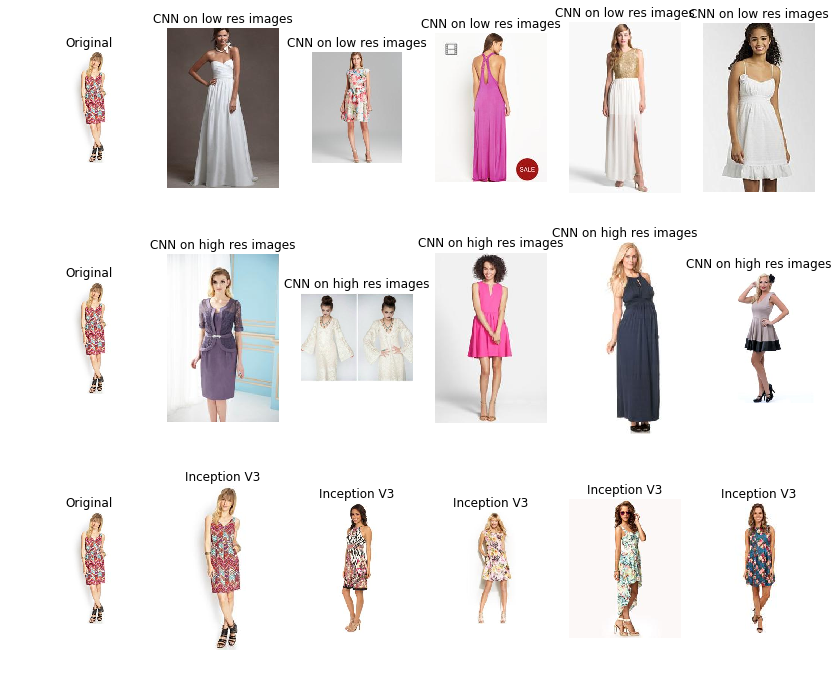

In [12]:
i = int(images_test[0])
compare_models(i, trees_test, predictions_test, labels_test, directory = 'data/img/',df=test_data, column='url')

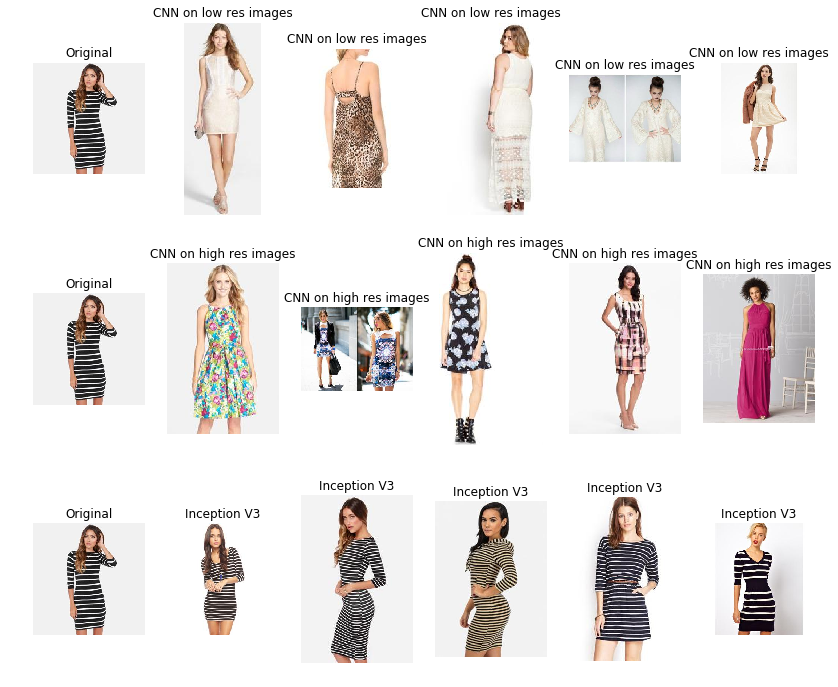

In [13]:
i = int(images_test[1])
compare_models(i, trees_test, predictions_test, labels_test, directory = 'data/img/',df=test_data, column='url')

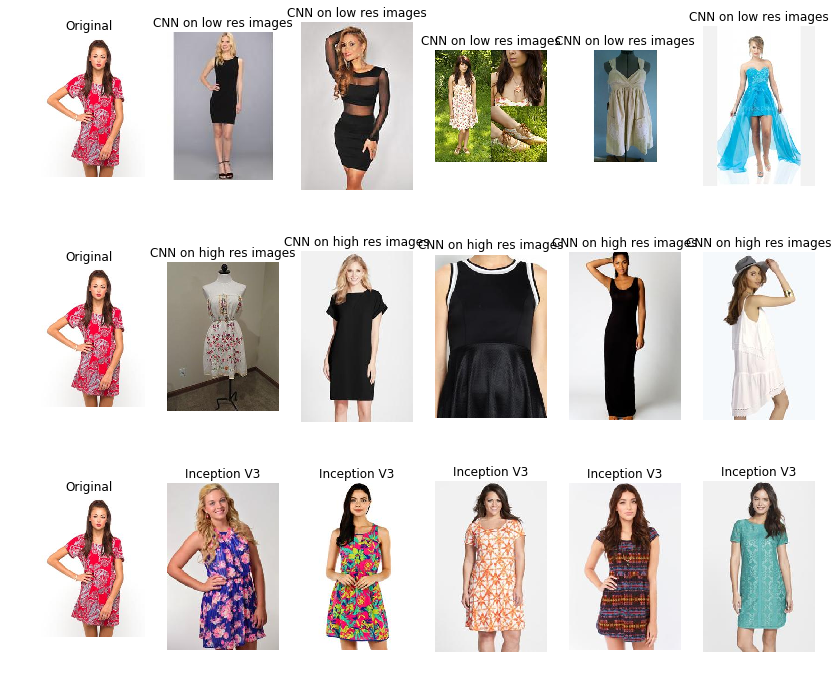

In [14]:
i = int(images_test[2])
compare_models(i, trees_test, predictions_test, labels_test, directory = 'data/img/',df=test_data, column='url')

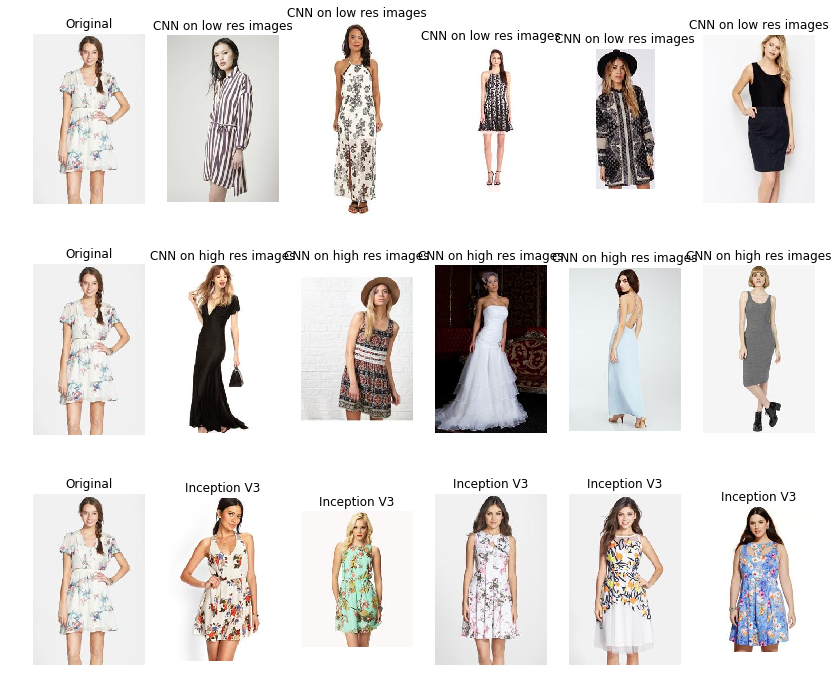

In [15]:
i = int(images_test[3])
compare_models(i, trees_test, predictions_test, labels_test, directory = 'data/img/',df=test_data, column='url')

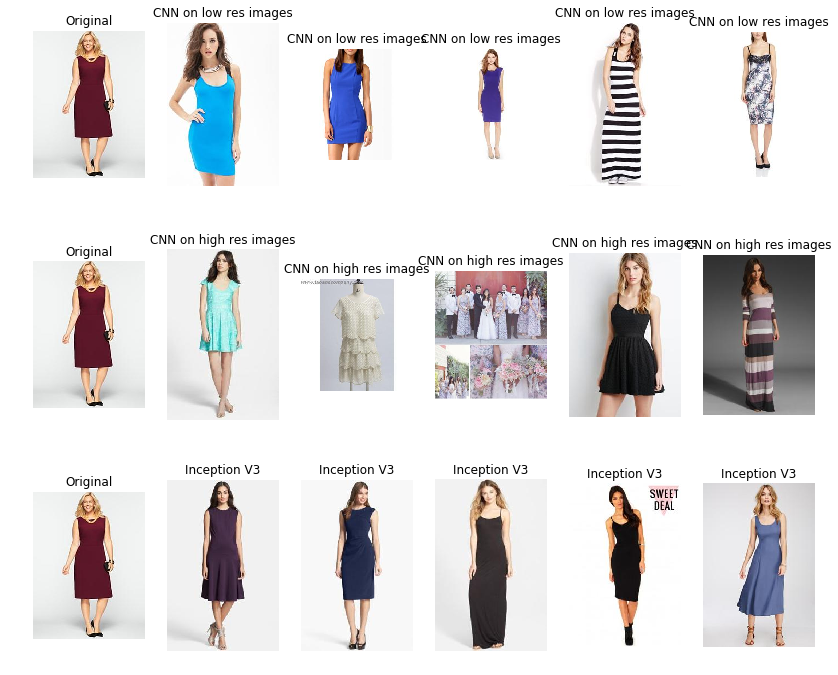

In [16]:
i = int(images_test[4])
compare_models(i, trees_test, predictions_test, labels_test, directory = 'data/img/',df=test_data, column='url')

The results above are showing that features extracted from Inception V3 model yield a lot better results. Lets now see what is the outcome for other test sets.

In [17]:
# build and define models to group dresses in small unlabeled set for 3 CNNs
tree_small_lr_auto = NearestNeighbors(algorithm='auto')
tree_small_lr_auto.fit(small_predictions_lr)

tree_small_hr_auto = NearestNeighbors(algorithm='auto')
tree_small_hr_auto.fit(small_predictions_hr)

tree_small_V3_auto = NearestNeighbors(algorithm='auto')
tree_small_V3_auto.fit(small_predictions_V3)

print('Unsupervised models for small test dresses dataset trained')

Unsupervised models for small test dresses dataset trained


In [18]:
# create lists to feed the function
trees_small = [tree_small_lr_auto, tree_small_hr_auto, tree_small_V3_auto]
predictions_small = [small_predictions_lr, small_predictions_hr, small_predictions_V3]
labels_small = ['CNN on low res', 'CNN on high res', 'Inception V3']

In [19]:
# extract indexes for small dress dataset to be tested
images_small = images_to_test.loc[2,'random_nums'].strip('][').split(', ') 

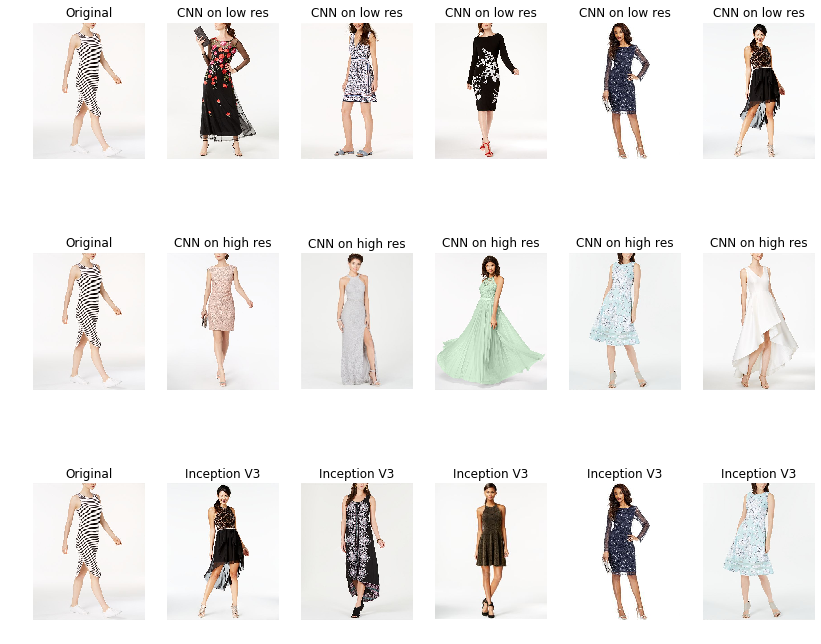

In [20]:
i = int(images_small[0])
compare_models(i, trees_small, predictions_small, labels_small, directory = '',df=test_dresses_small, column='url')

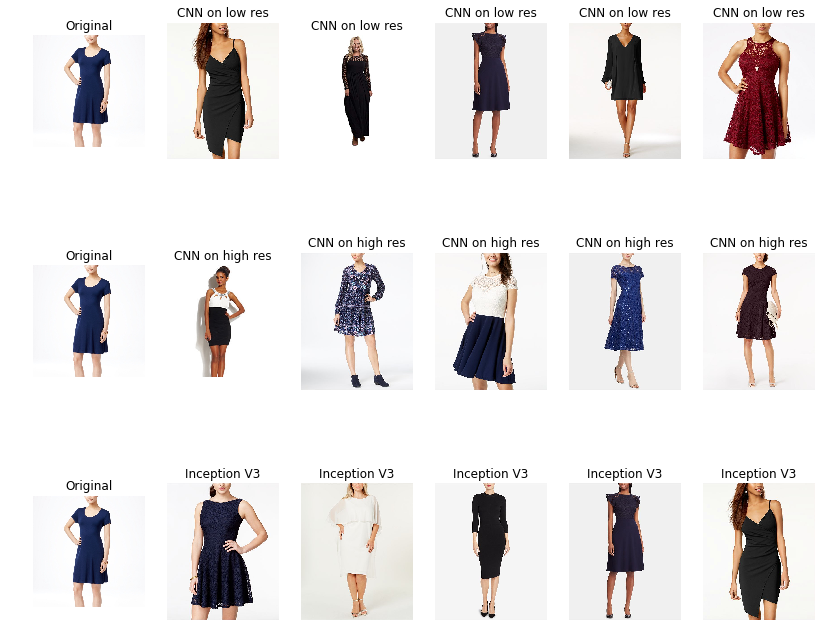

In [21]:
i = int(images_small[1])
compare_models(i, trees_small, predictions_small, labels_small, directory = '',df=test_dresses_small, column='url')

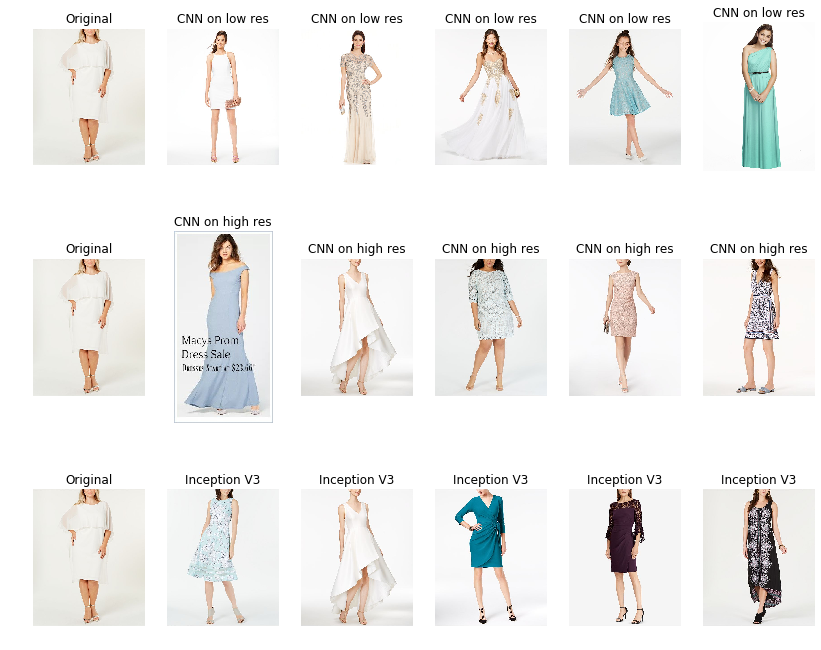

In [22]:
i = int(images_small[2])
compare_models(i, trees_small, predictions_small, labels_small, directory = '',df=test_dresses_small, column='url')

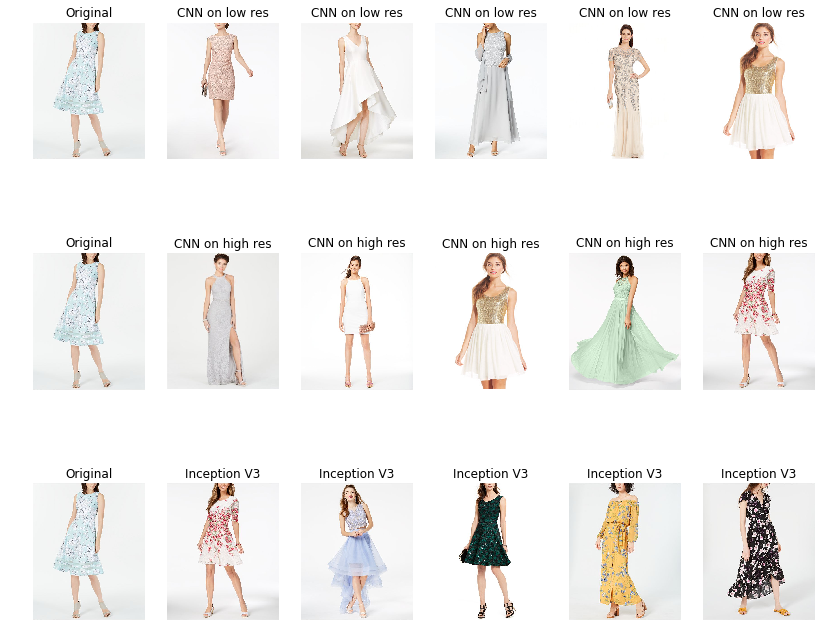

In [23]:
i = int(images_small[3])
compare_models(i, trees_small, predictions_small, labels_small, directory = '',df=test_dresses_small, column='url')

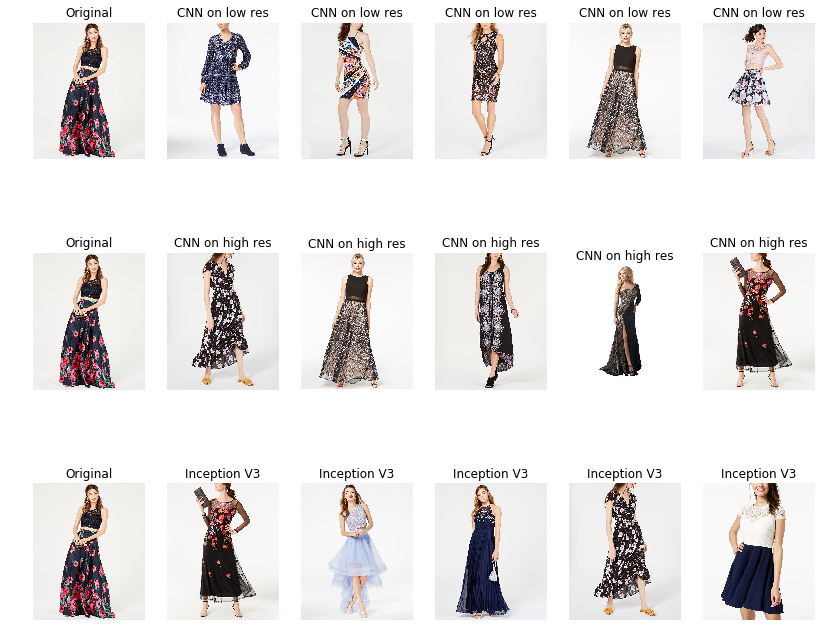

In [24]:
i = int(images_small[4])
compare_models(i, trees_small, predictions_small, labels_small, directory = '',df=test_dresses_small, column='url')

The results for a small dataset are not that great for all of the models. It might be because the set only contains 101 dress and they are not much similar. In situation like this it might not be necessary to use pre-trained model and store long feature vectors. A simpler model (preferrably trained on high resolution images) can be a great alternative. In this case the customer will not see very similar dresses, but will get some idea what other items the seller can offer in similar category.

Lets see now how will models perform with a larger set of unknown dresses.

In [32]:
# build and define models to group dresses in small unlabeled set for 3 CNNs 
tree_large_lr_auto = NearestNeighbors(algorithm='auto')
tree_large_lr_auto.fit(large_predictions_lr)

tree_large_hr_auto = NearestNeighbors(algorithm='auto')
tree_large_hr_auto.fit(large_predictions_hr)

tree_large_V3_auto = NearestNeighbors(algorithm='auto')
tree_large_V3_auto.fit(large_predictions_V3)

print('Unsupervised models for large test dresses dataset trained')

Unsupervised models for large test dresses dataset trained


In [33]:
# create lists to feed the function
trees_large = [tree_large_lr_auto, tree_large_hr_auto, tree_large_V3_auto]
predictions_large = [large_predictions_lr, large_predictions_hr, large_predictions_V3]
labels_large = ['CNN on low res', 'CNN on high res', 'Inception V3']

In [34]:
# extract indexes for large dress dataset to be tested
images_large = images_to_test.loc[3,'random_nums'].strip('][').split(', ') 

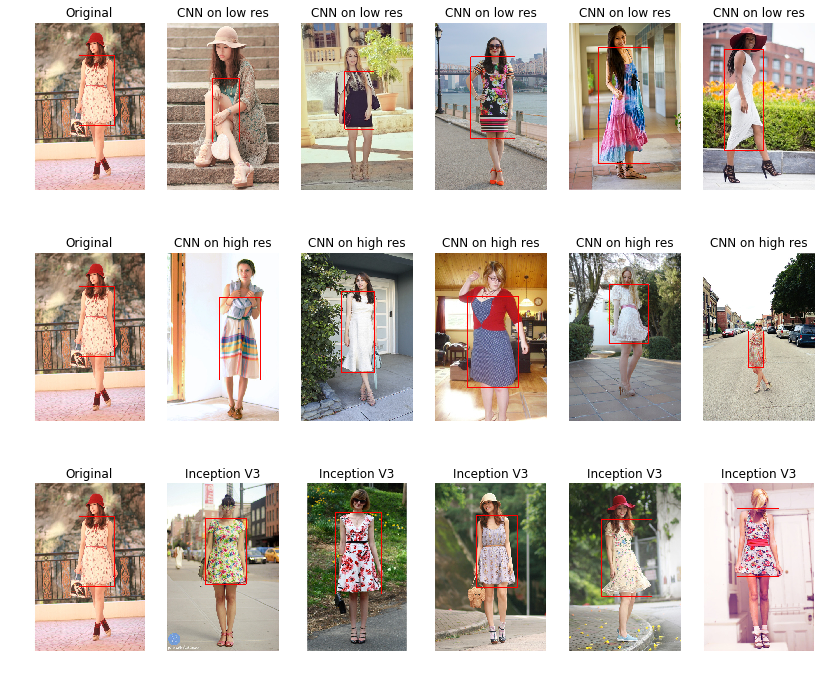

In [35]:
i = int(images_large[0])
compare_models(i, trees_large, predictions_large, labels_large, directory = '',df=test_dresses_large, column='url')

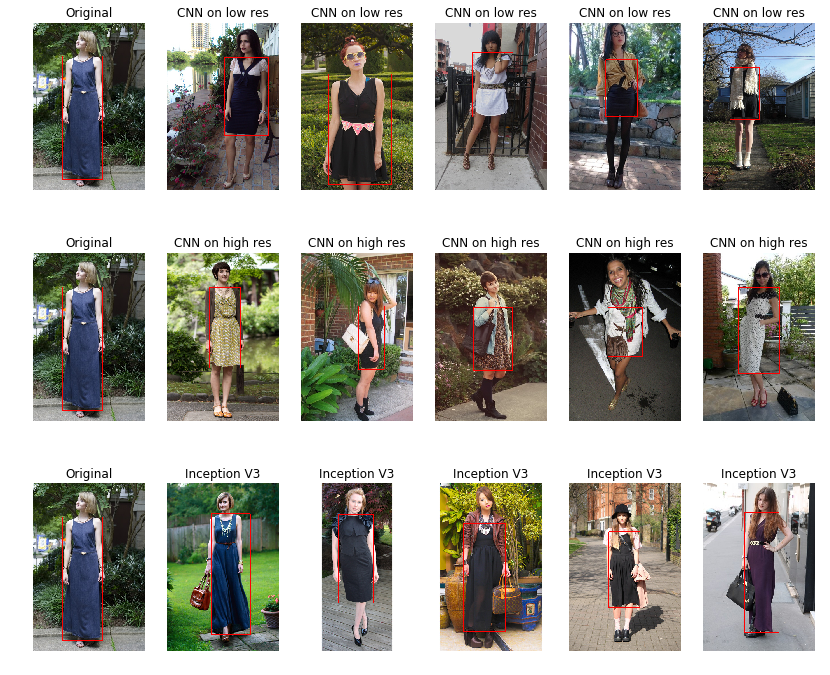

In [36]:
i = int(images_large[1])
compare_models(i, trees_large, predictions_large, labels_large, directory = '',df=test_dresses_large, column='url')

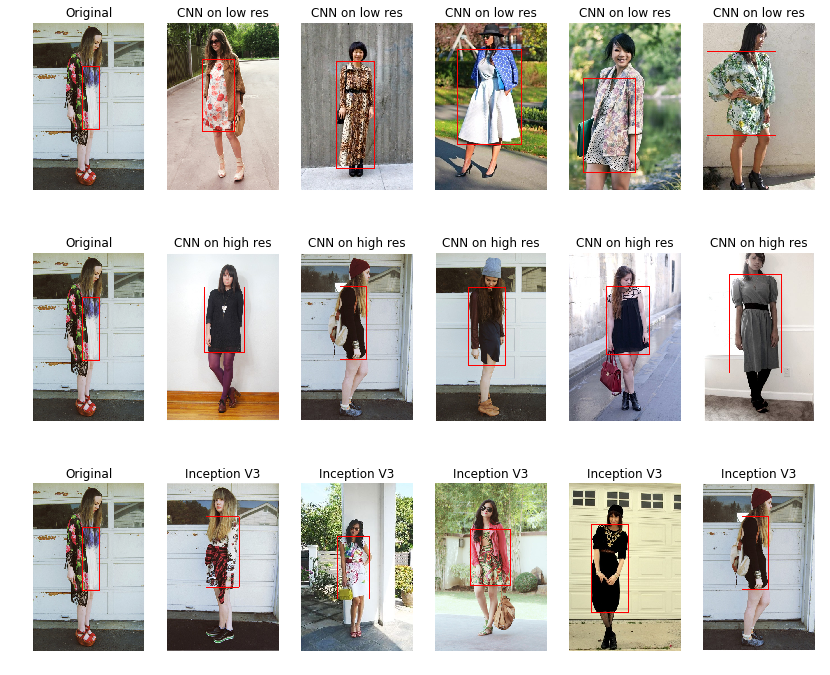

In [37]:
i = int(images_large[2])
compare_models(i, trees_large, predictions_large, labels_large, directory = '',df=test_dresses_large, column='url')

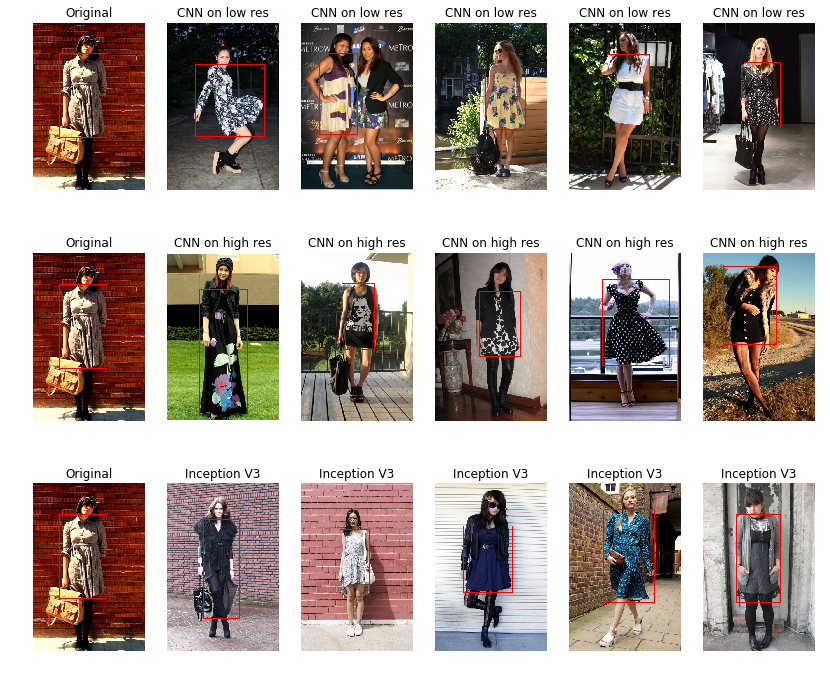

In [38]:
i = int(images_large[3])
compare_models(i, trees_large, predictions_large, labels_large, directory = '',df=test_dresses_large, column='url')

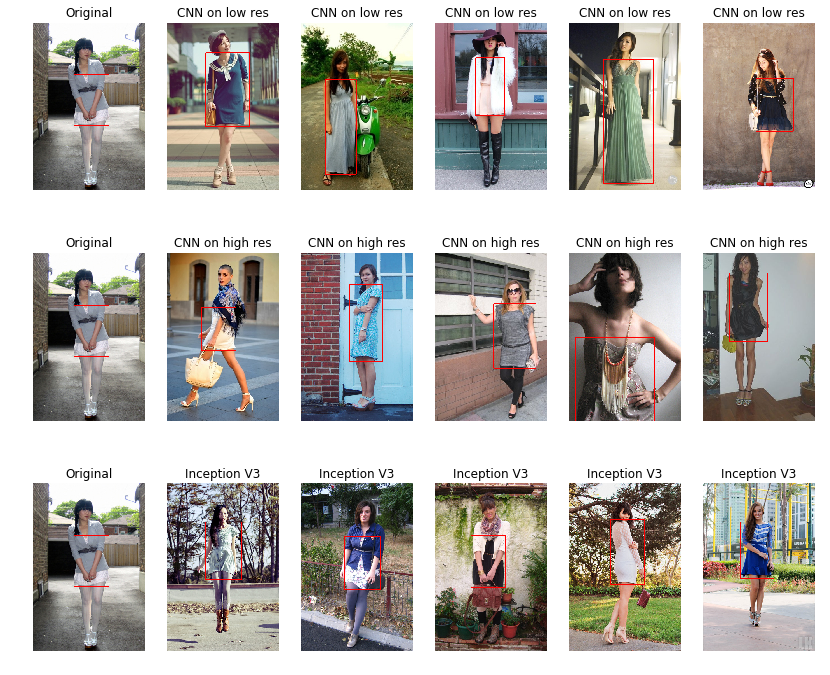

In [39]:
i = int(images_large[4])
compare_models(i, trees_large, predictions_large, labels_large, directory = '',df=test_dresses_large, column='url')

With larger collection of images the features extracted with the help of Inception V3 model gave better results,, even for some tricky images. Let's now see if a different algorithm used for Nearest Neighbor model can change the performance.

In [40]:
# build and define models to group dresses in small unlabeled set for 3 CNNs with KD tree algorithm
tree_large_V3_ball = NearestNeighbors(algorithm='ball_tree')
tree_large_V3_ball.fit(large_predictions_V3)

tree_large_V3_brute = NearestNeighbors(algorithm='brute')
tree_large_V3_brute.fit(large_predictions_V3)

tree_large_V3_kd = NearestNeighbors(algorithm='kd_tree')
tree_large_V3_kd.fit(large_predictions_V3)

print('Unsupervised models for large test dresses dataset trained with KD tree algorithm')

# create lists to feed the function

trees_large_V3 = [tree_large_V3_auto, tree_large_V3_ball, tree_large_V3_brute, tree_large_V3_kd]
predictions_large_V3 = [large_predictions_V3, large_predictions_V3, large_predictions_V3, large_predictions_V3]
labels_large_V3 = ['Auto', 'Ball Tree', 'Brute', 'KD Tree']

Unsupervised models for large test dresses dataset trained with KD tree algorithm


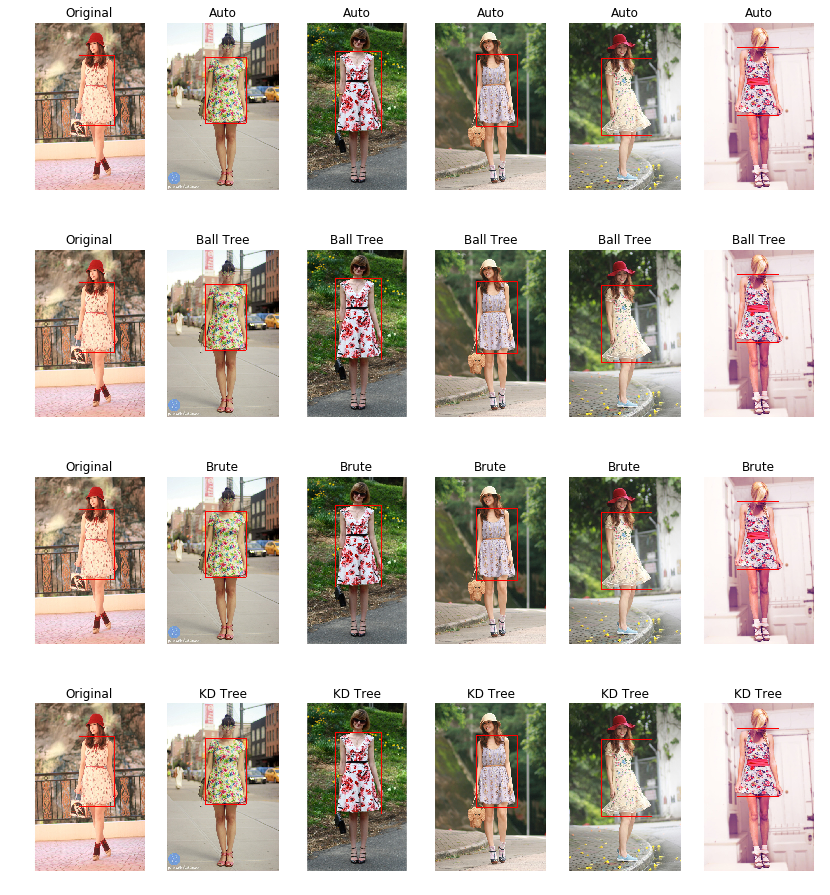

In [41]:
i = int(images_large[0])
compare_models(i, trees_large_V3, predictions_large_V3, labels_large_V3, directory = '',df=test_dresses_large, column='url')

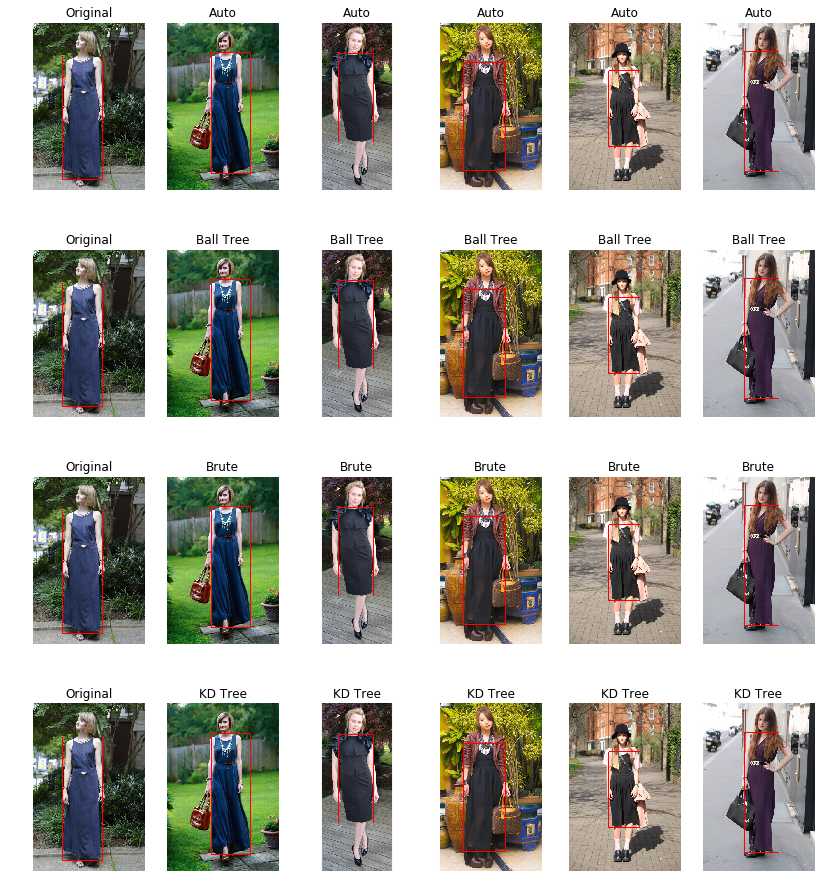

In [42]:
i = int(images_large[1])
compare_models(i, trees_large_V3, predictions_large_V3, labels_large_V3, directory = '',df=test_dresses_large, column='url')

Changing the algorithm did not give any changes. Let's try to change leaf size. Default is 30. I wil try 10,20 and 40 additionally.

In [44]:
# train unsupervised model
tree_large_V3_10 = NearestNeighbors(leaf_size=10)
tree_large_V3_10.fit(large_predictions_V3)

tree_large_V3_20 = NearestNeighbors(leaf_size=20)
tree_large_V3_20.fit(large_predictions_V3)

tree_large_V3_40 = NearestNeighbors(leaf_size=40)
tree_large_V3_40.fit(large_predictions_V3)

# construct lists for comparison function
trees_large_V3_ls = [tree_large_V3_10, tree_large_V3_20,tree_large_V3_auto, tree_large_V3_40]
labels_large_V3_ls = ['10', '20', '30', '40']

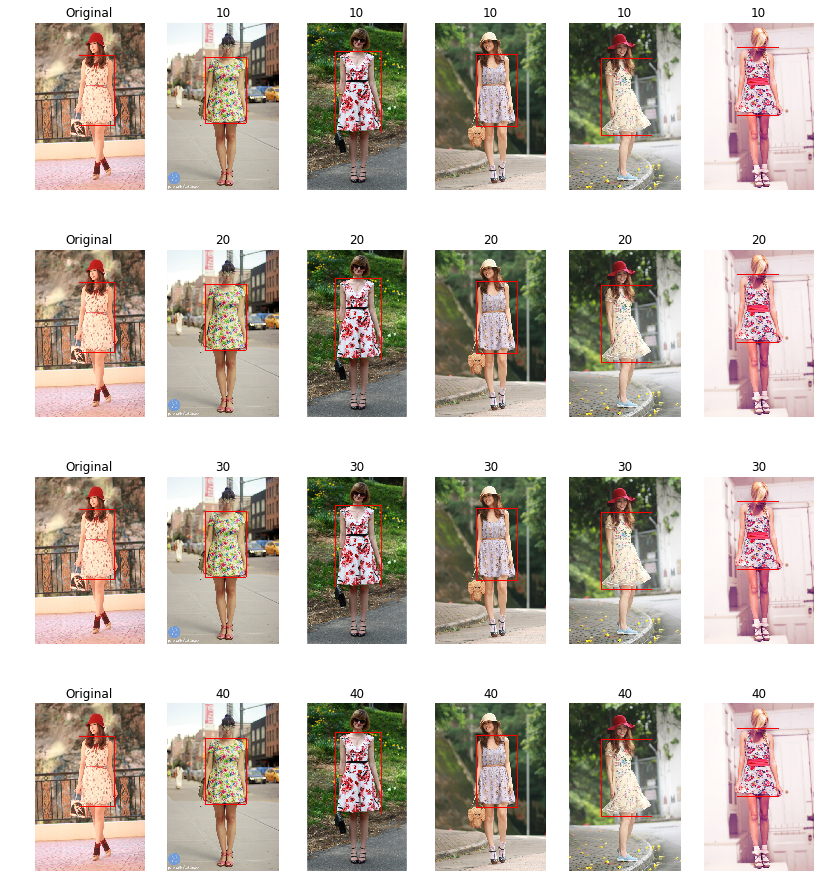

In [45]:
i = int(images_large[0])
compare_models(i, trees_large_V3_ls, predictions_large_V3, labels_large_V3_ls, directory = '',df=test_dresses_large, column='url')

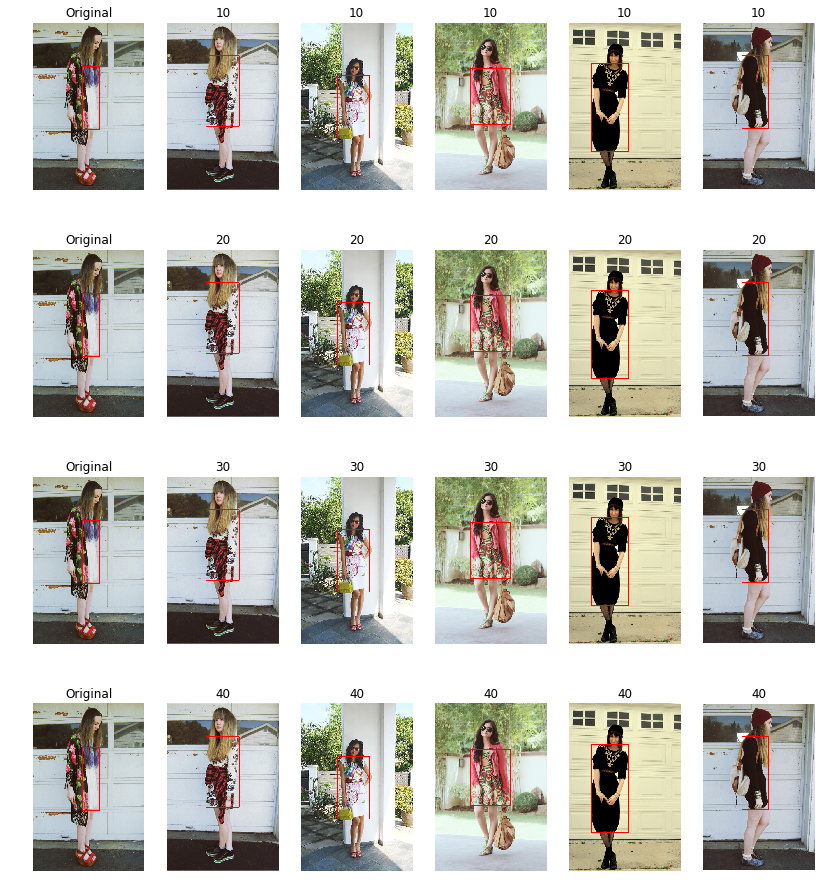

In [66]:
i = int(images_large[2])
compare_models(i, trees_large_V3_ls, predictions_large_V3, labels_large_V3_ls, directory = '',df=test_dresses_large, column='url')

Lets try play with metrics and see if there will be any result changes. Default is minkowski, with p=2 (default value) it is the same as euclidean one. I will also try “manhattan”=sum(|x - y|), “chebyshev”=max(|x - y|) and Minkowski with p=3.

In [47]:
# train unsupervised model
tree_large_V3_manhattan = NearestNeighbors(metric='manhattan')
tree_large_V3_manhattan.fit(large_predictions_V3)

tree_large_V3_chebyshev = NearestNeighbors(metric='chebyshev')
tree_large_V3_chebyshev.fit(large_predictions_V3)

tree_large_V3_mink3 = NearestNeighbors(metric='minkowski', p=3)
tree_large_V3_mink3.fit(large_predictions_V3)


# construct lists for comparison function
trees_large_V3_metric = [tree_large_V3_auto, tree_large_V3_mink3, tree_large_V3_manhattan,tree_large_V3_chebyshev]
predictions_large_V3_metric = [large_predictions_V3, large_predictions_V3, large_predictions_V3, large_predictions_V3]
labels_large_V3_metrcic = ['Minkowski, p=2', 'Minkowski, p=3', 'Manhattan', 'Chebyshev']

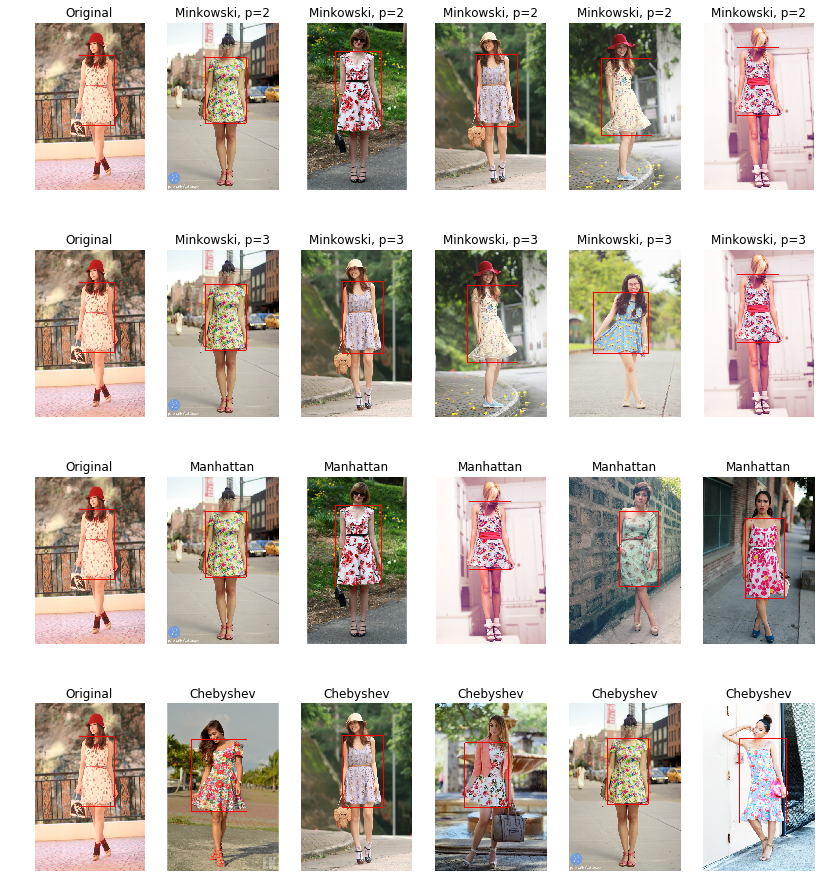

In [48]:
i = int(images_large[0])
compare_models(i, trees_large_V3_metric, predictions_large_V3_metric, labels_large_V3_metrcic, directory = '',df=test_dresses_large, column='url')

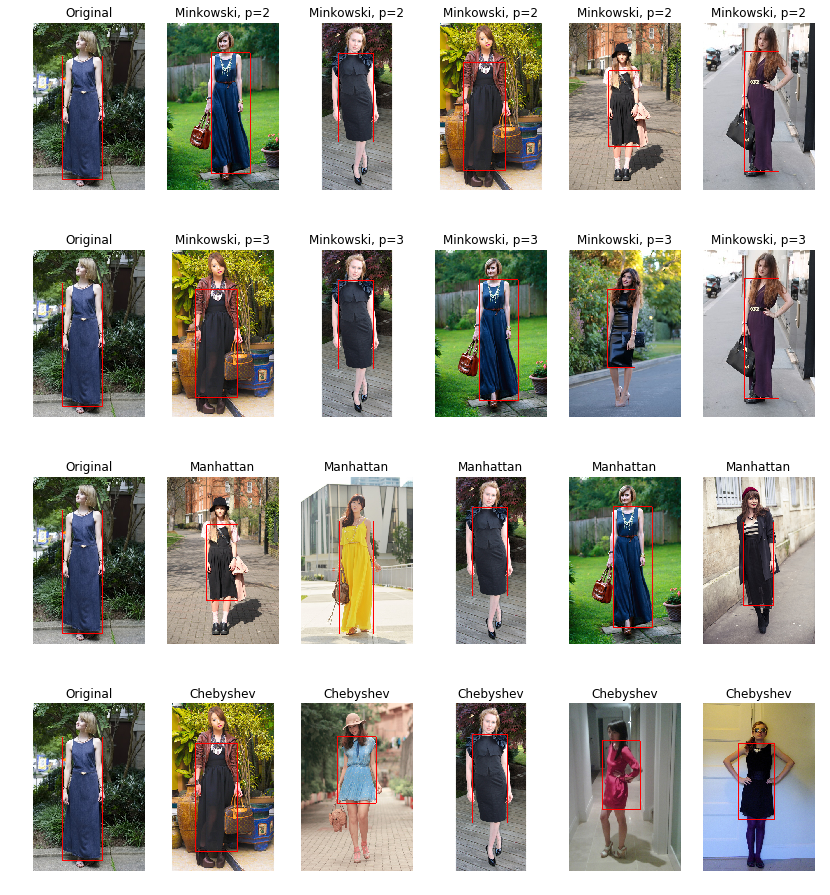

In [49]:
i = int(images_large[1])
compare_models(i, trees_large_V3_metric, predictions_large_V3_metric, labels_large_V3_metrcic, directory = '',df=test_dresses_large, column='url')

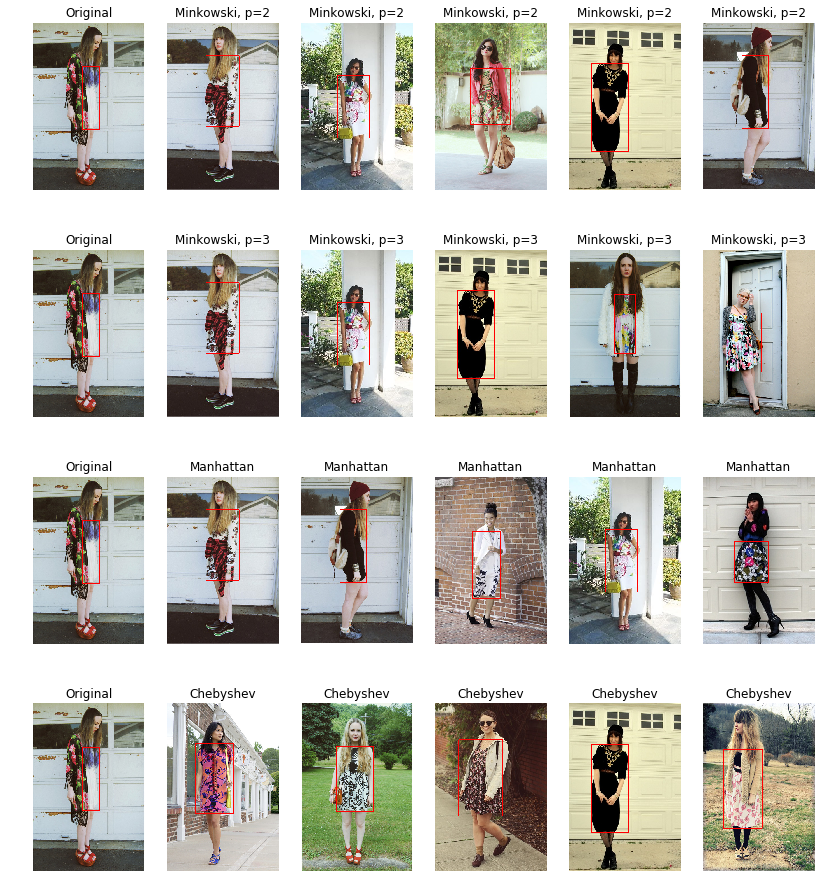

In [50]:
i = int(images_large[2])
compare_models(i, trees_large_V3_metric, predictions_large_V3_metric, labels_large_V3_metrcic, directory = '',df=test_dresses_large, column='url')

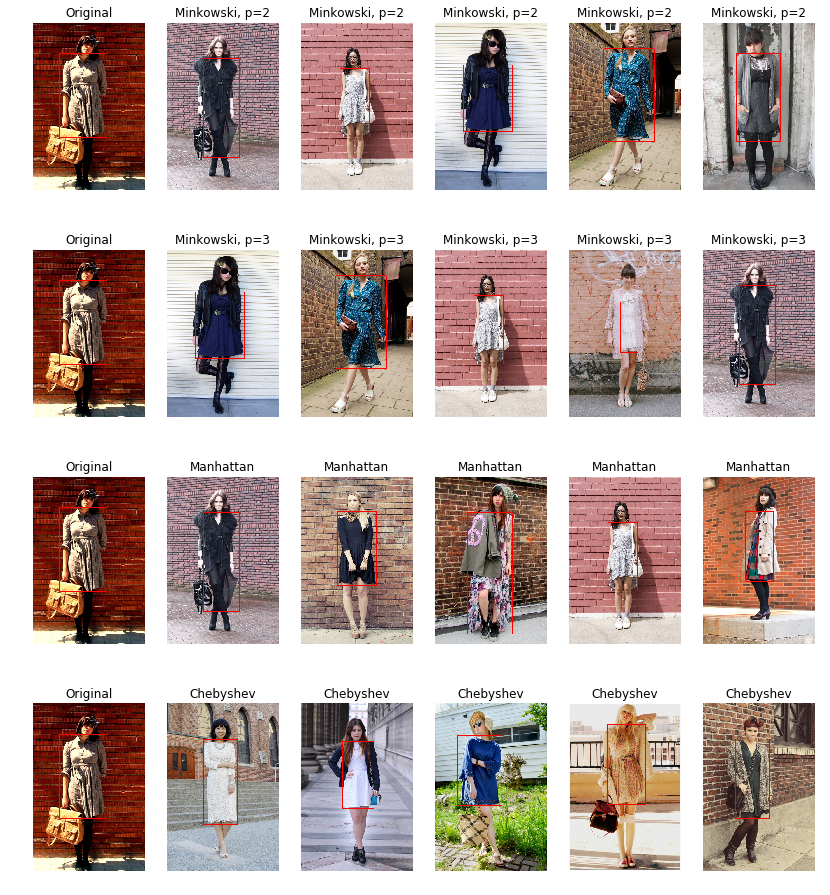

In [51]:
i = int(images_large[3])
compare_models(i, trees_large_V3_metric, predictions_large_V3_metric, labels_large_V3_metrcic, directory = '',df=test_dresses_large, column='url')

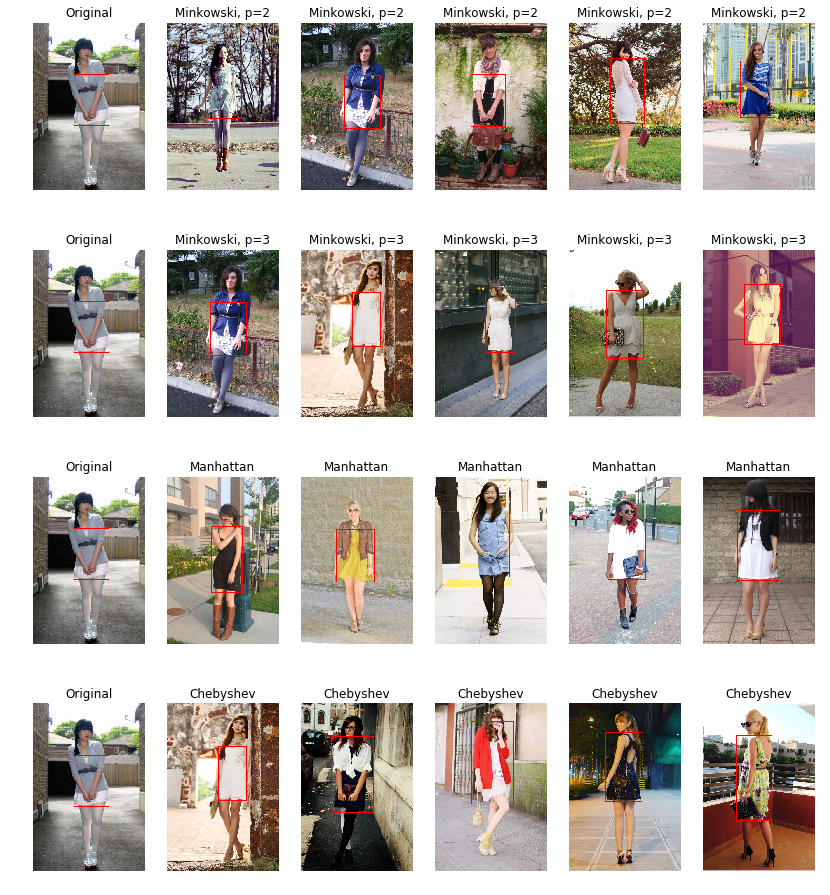

In [52]:
i = int(images_large[4])
compare_models(i, trees_large_V3_metric, predictions_large_V3_metric, labels_large_V3_metrcic, directory = '',df=test_dresses_large, column='url')

Changing a metric did change the results, but it is still very difficult to pick which one produces better results. Especially when some of the images are proposed based on their background as well. I will re-test different metrics on the test data from the main dataset.

In [53]:
# train unsupervised model
tree_V3_manhattan = NearestNeighbors(metric='manhattan')
tree_V3_manhattan.fit(test_predictions_V3)

tree_V3_chebyshev = NearestNeighbors(metric='chebyshev')
tree_V3_chebyshev.fit(test_predictions_V3)

tree_V3_mink3 = NearestNeighbors(metric='minkowski', p=3)
tree_V3_mink3.fit(test_predictions_V3)


# construct lists for comparison function
trees_test_V3_metric = [tree_test_V3_auto, tree_V3_mink3, tree_V3_manhattan,tree_V3_chebyshev]
predictions_test_V3_metric = [test_predictions_V3, test_predictions_V3, test_predictions_V3, test_predictions_V3]
labels_test_V3_metrcic = ['Minkowski, p=2', 'Minkowski, p=3', 'Manhattan', 'Chebyshev']

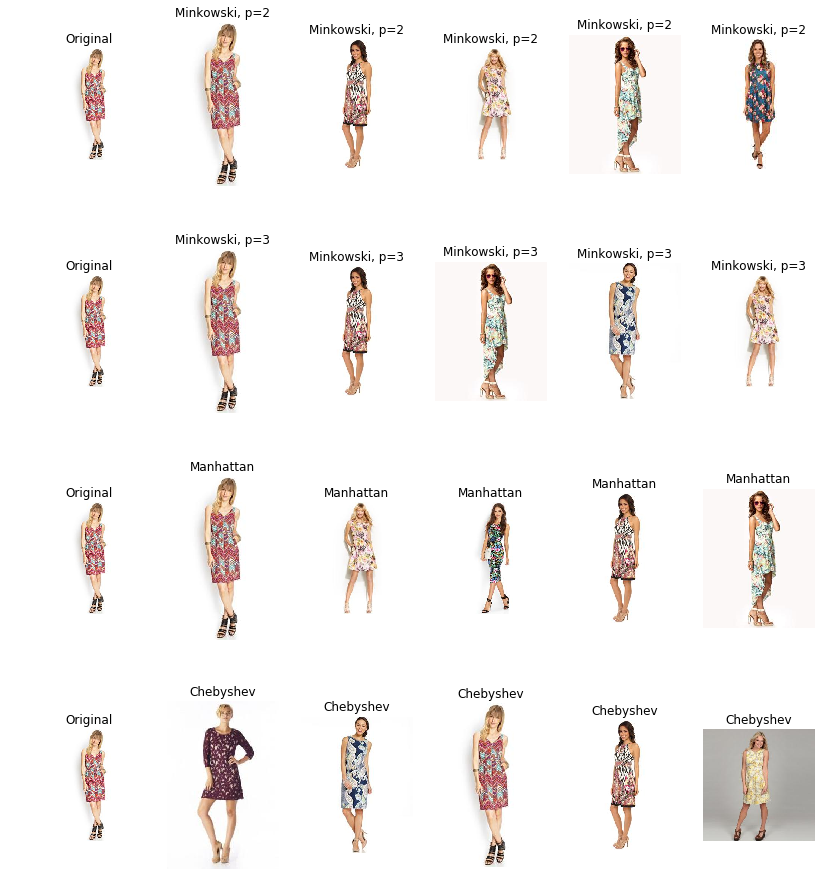

In [59]:
i = int(images_test[0])
compare_models(i, trees_test_V3_metric, predictions_test_V3_metric, labels_test_V3_metrcic, directory = 'data/img/',df=test_data, column='url')

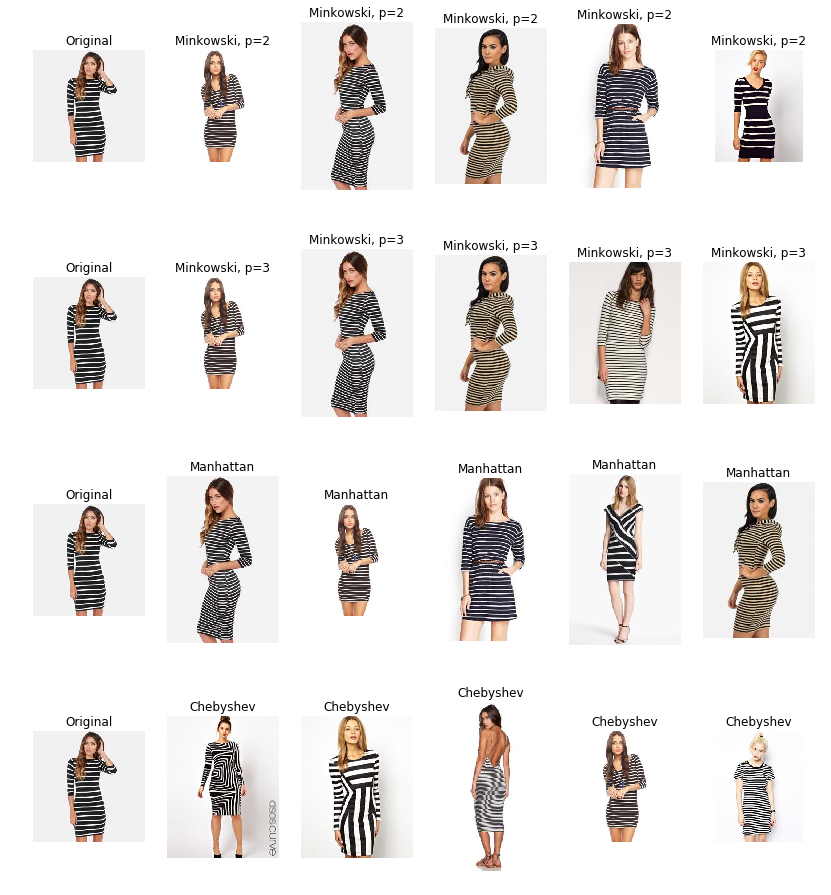

In [60]:
i = int(images_test[1])
compare_models(i, trees_test_V3_metric, predictions_test_V3_metric, labels_test_V3_metrcic, directory = 'data/img/',df=test_data, column='url')

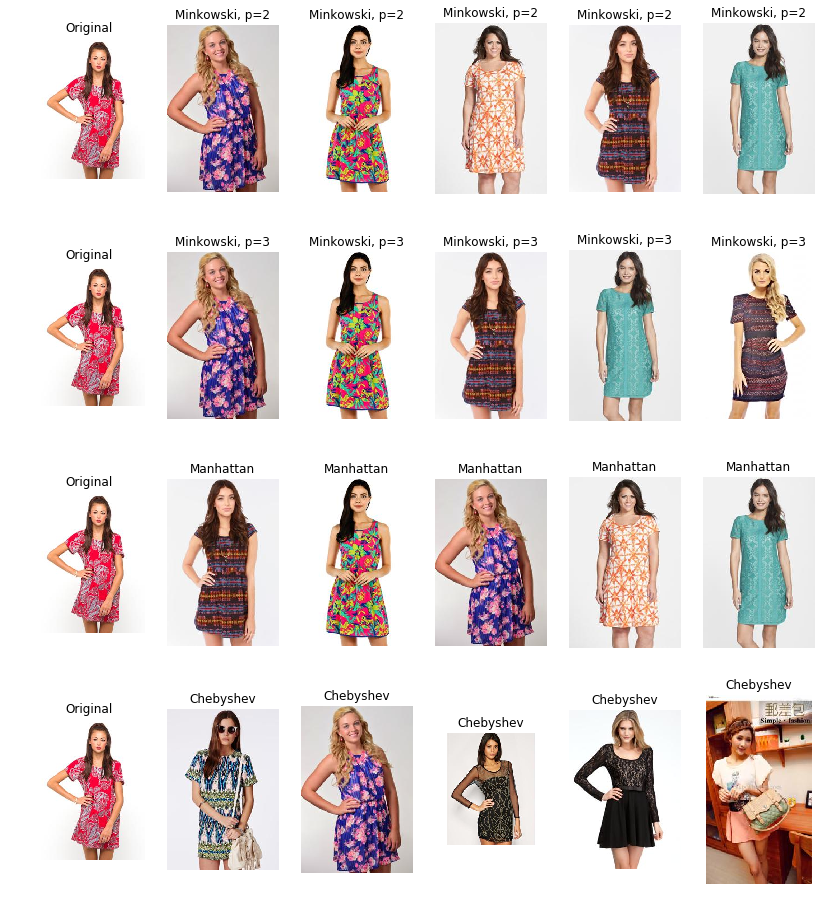

In [61]:
i = int(images_test[2])
compare_models(i, trees_test_V3_metric, predictions_test_V3_metric, labels_test_V3_metrcic, directory = 'data/img/',df=test_data, column='url')

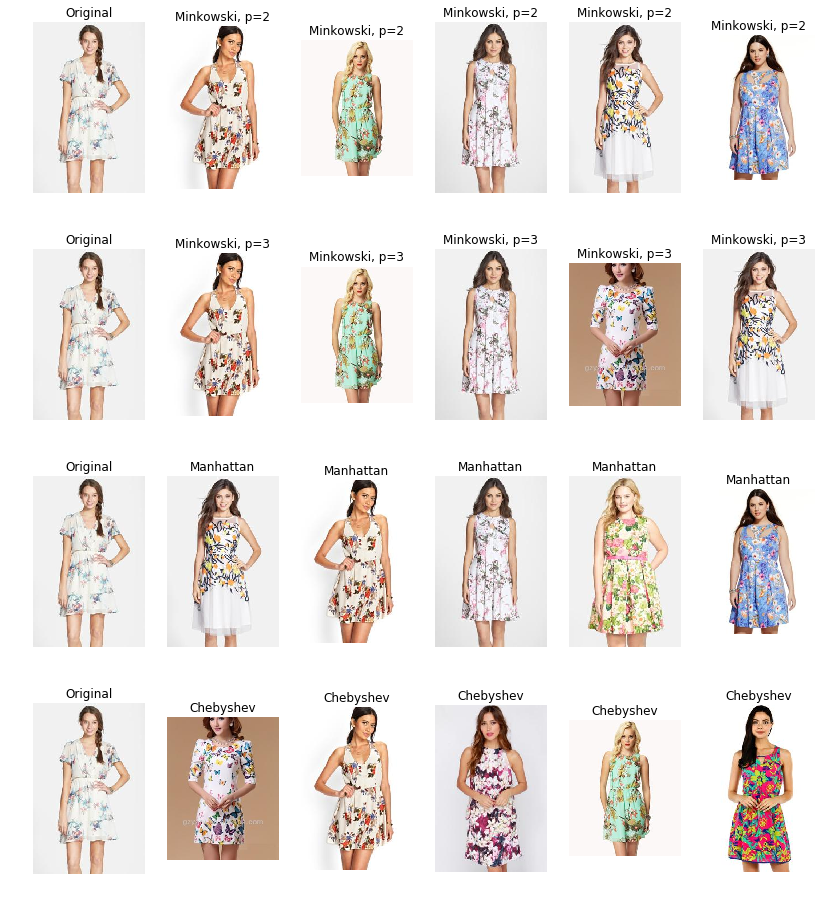

In [62]:
i = int(images_test[3])
compare_models(i, trees_test_V3_metric, predictions_test_V3_metric, labels_test_V3_metrcic, directory = 'data/img/',df=test_data, column='url')

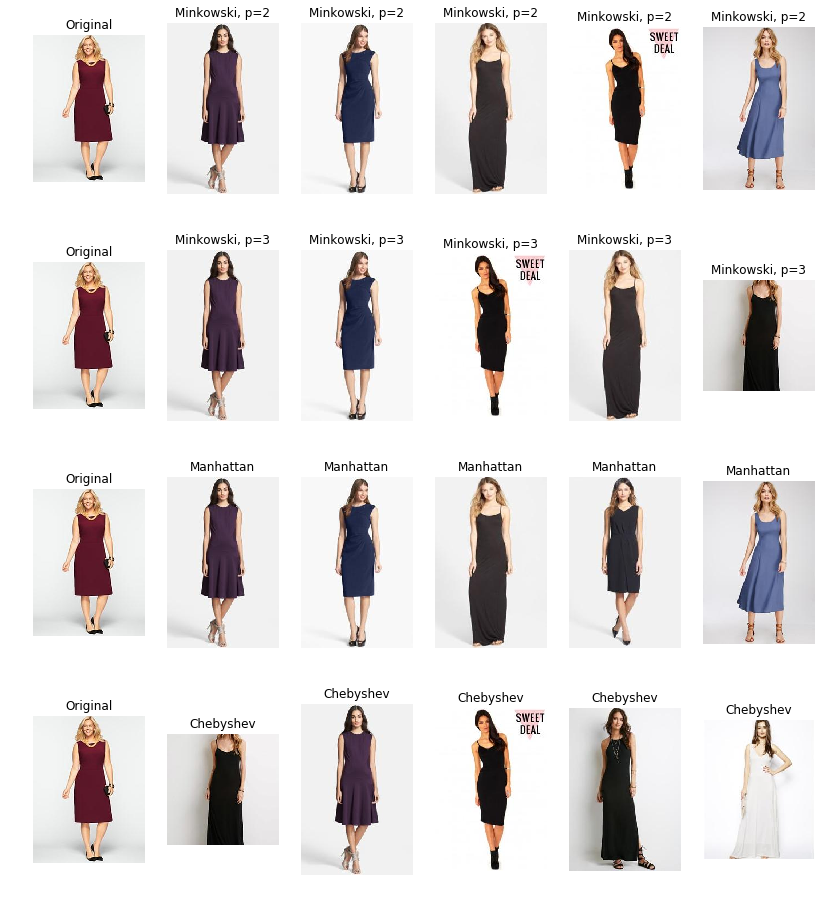

In [63]:
i = int(images_test[4])
compare_models(i, trees_test_V3_metric, predictions_test_V3_metric, labels_test_V3_metrcic, directory = 'data/img/',df=test_data, column='url')

These results show that Minkowski metric with either p=2 or p=3 provide the best results. The difference between outcomes of p=2 and p=3 is not significant, in most cases at least 4 out of 5 suggested dresses are the same for both metrics. In this case either model can be implemented.

As initially mentioned, the results of the model cannot be immediately quantified, there is no single number (not even a set of them) to measure the goodness of the model. The good way to determine model's usefulness will be to create A|B test where two different versions of the website are created. One will be without similar dress suggestions and one with. The sales results from both pages will be an interesting comparison point. 

Another idea of model testing is based on measuring click rates on the suggested dresses and maybe even purchase history of those. 

In any case it can be a great tool for online websites and mobile retail applications, that can benefit both: consumers (they will see similar items and may discover things they would not find other way) and retailers (they will be able to display different merchandise including less known brands that may visually look like more well-known ones.